# Function definitions and library imports

In [30]:
import numpy as np
import matplotlib.pyplot as plt
#from mpl_toolkits.mplot3d import Axes3D
from sklearn.decomposition import PCA
from sklearn.preprocessing import normalize

import math
from sympy import Point3D, Line3D, Plane
from scipy.spatial import Delaunay
import csv
#import matplotlib.colors as mcolors
%matplotlib inline

!pip install mplstereonet
import mplstereonet as mpl

import plotly.graph_objects as go
import plotly.express as px
import pandas as pd

!pip install spherical_kde
import spherical_kde

In [31]:
def load_planes_from_file(File):
    #File = 'Soledade_VR.data'
    strike = []
    dip = []
    centroids = []
    normals = []
    a_value = []
    b_value = []
    c_value = []
    d_value = []
    with open(File) as csv_file:
        csv_reader = csv.reader(csv_file, delimiter=' ')

        row_count = 0
        for row in csv_reader:
          for cell in row:
            if cell == 'Plane':
              planes_start = int(row[1])
              planes_end = int(row[2]) + int(row[1])
              break

          if row_count >= planes_start and row_count < planes_end:
            points = []
            for i in range(np.size(row)):
              if i > 2 and i < np.size(row)-1:
                points.append(float(row[i]))
            points = np.reshape(points, (int(np.size(points)/3), 3))
            points = np.asarray([points[:,0], points[:,2], -points[:,1]]).T

            pca = PCA(n_components=3)
            pca.fit(points)
            eig_vec = pca.components_

            normal = eig_vec[2, :]  # (a, b, c)
            normals.append(normal)
            centroid = np.mean(points, axis=0)
            centroids.append(centroid)

            d = -centroid.dot(normal)

            a, b, c = normal
            alpha = math.acos(abs(c/(math.sqrt((math.pow(a, 2) + math.pow(b, 2)
                                                + math.pow(c, 2))))))
            beta = math.acos(a/(math.sqrt(math.pow(a, 2) + math.pow(b, 2))))

            dip.append(math.degrees(alpha))
            a_value.append(a)
            b_value.append(b)
            c_value.append(c)
            d_value.append(d)

            if a > 0 and b > 0: # quadrante 2 #*
                strike.append(360-math.degrees(beta))
            elif a > 0 and b < 0: # quadrante 3
                strike.append(180+math.degrees(beta)) #* 180+
            elif a < 0 and b < 0: # quadrante 4
                strike.append(math.degrees(beta)) #*
            else: # quadrante 1
                strike.append(math.degrees(beta))

          row_count += 1

    return strike, dip, normals, centroids, a_value, b_value, c_value, d_value

In [32]:
def quadrante(valor):
    a = np.where(valor > 270, valor,(np.where(valor > 180 , valor -180, (np.where(valor>90,valor+180,valor)))))
    return a

In [33]:
def rosechart(angles):

    # angles = segm_group_angles[:, 0]
    bin_edges = np.arange(-5, 366, 10)
    number_of_strikes, bin_edges = np.histogram(angles, bin_edges)

    number_of_strikes[0] += number_of_strikes[-1]

    half = np.sum(np.split(number_of_strikes[:-1], 2), 0)
    two_halves = np.concatenate([half, half])

    fig = plt.figure(figsize=(5, 5))
    ax = fig.add_subplot(111, projection='polar')

    ax.bar(np.deg2rad(np.arange(0, 360, 10)), two_halves,
           width=np.deg2rad(10), bottom=0.0, color='red', edgecolor='k')
    ax.set_theta_zero_location('N')
    ax.set_theta_direction(-1)
    ax.set_thetagrids(np.arange(0, 360, 10), labels=np.arange(0, 360, 10))
    # ax.set_rgrids(np.arange(1, two_halves.max()+1, 2),angle=0,weight='black')
    ax.set_title("N = "+str(np.size(angles)), y=1.10, fontsize=25)
    # plt.show()
    fig.tight_layout()
    fig.canvas.draw()

    # Now we can save it to a numpy array.
    plot = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
    plot = plot.reshape(fig.canvas.get_width_height()[::-1] + (3,))

    plt.show()

    return plot

In [34]:
def fisher_stats(plunge, trend):

    trend_rad = trend*np.pi/180 #imprime usando a função e trend em rad
    plunge = plunge*np.pi/180 #plung em rad

    #########CRONIN2008
    l = np.cos(plunge) * np.cos(trend_rad)
    m = np.cos(plunge) * np.sin(trend_rad)
    n = np.sin(plunge)
        
    #mean dip vector l,m,n   (soma dos valores)
    l_soma = l.sum()
    m_soma = m.sum()
    n_soma = n.sum()

    #R = vetor resultante
    r = np.sqrt(l_soma**2 + m_soma**2 + n_soma**2)

    #unit vector l,m,n
    l_unit = l_soma/r
    m_unit = m_soma/r
    n_unit = n_soma/r

    #delta (ângulo plunge of mean dip vector) em graus
    delta_rad = np.arcsin(n_unit)
    delta_graus= np.arcsin(n_unit)*180/np.pi

    #trend (direção média do conjunto) em graus
    trend_m = np.where(m_unit < 0, 360- np.arccos(l_unit/np.cos(delta_rad)), np.arccos(l_unit/np.cos(delta_rad)))*180/np.pi

    #k (dispersão dos dados)
    qt = len(trend)
    k = (qt-1)/(qt-r)

    #O raio do cone do intervalo de confiança de 95% (α95) em graus
    alpha95_rad = np.arccos(1-((qt-r)/r)*(((1/0.05)**(1/(qt-1)))-1))
    alpha95_graus = alpha95_rad*180/np.pi

    #Erro total: soma o erro aleatório (do equipamento) - para Brunton 0.5° a 1°
    r_total = np.sqrt((alpha95_rad**2) + ((1*np.pi/180)**2))
    r_total_graus = r_total*180/np.pi

    return trend_m, delta_graus, k, qt

In [35]:
# poles, planes or lines?
def fisher_plot(plunge, bearing, strike, dip):
    fig = plt.figure()
    ax = fig.add_subplot(111, projection='stereonet')
    #ax.line(plunge, bearing, color="black", markersize=2)
    ax.pole(strike, dip, color="black", markersize=2)
    confidence = 95

    # plunge = dip / trend = bearing = strike
    vector, stats = mpl.find_fisher_stats(plunge, bearing, conf=confidence)

    template = (u"Mean Strike/Dip: {strike:0.0f}\u00B0/{dip:0.0f}\u00B0\n"
                "Confidence: {conf}%\n"
                u"Fisher Angle: {fisher:0.2f}\u00B0\n"
                u"R-Value {r:0.3f}\n"
                "K-Value: {k:0.2f}")
    
    mean_strike, mean_dip = mpl.plunge_bearing2pole(vector[0], vector[1])

    #mean_strike = np.where(mean_strike > 180, mean_strike - 180, mean_strike)

    label = template.format(strike=mean_strike[0], dip=mean_dip[0], conf=confidence,
                            r=stats[0], fisher=stats[1], k=stats[2])

    ax.pole(mean_strike, mean_dip, color="red", label=label)
    ax.cone(vector[0], vector[1], stats[1], facecolor="None", edgecolor="red")

    ax.legend(bbox_to_anchor=(1.1, 1.1), numpoints=1)
    plt.show()
    return mean_strike[0], mean_dip[0], stats

In [36]:
def plane_intersect(a, b):
    """
    a, b   4-tuples/lists
           Ax + By +Cz + D = 0
           A,B,C,D in order  

    output: 2 points on line of intersection, np.arrays, shape (3,)
    """
    a_vec, b_vec = np.array(a[:3]), np.array(b[:3])

    aXb_vec = np.cross(a_vec, b_vec)

    A = np.array([a_vec, b_vec, aXb_vec])
    d = np.array([-a[3], -b[3], 0.]).reshape(3,1)

# could add np.linalg.det(A) == 0 test to prevent linalg.solve throwing error

    p_inter = np.linalg.solve(A, d).T

    return p_inter[0], (p_inter + aXb_vec)[0]

#a, b = (1, -1, 0, 2), (-1, -1, 1, 3)
#plane_intersect(a, b)

In [37]:
def vnorm(vector):
    return np.sqrt(np.sum(np.power(vector, 2)))

def plane_rotate(points, normal, centroid):
    normal0 = np.cross(points[2], points[1])
    costheta = np.dot(normal0, np.reshape(normal, (-1,1)))/(vnorm(normal0) *vnorm(normal))
    axis = np.cross(normal0, normal)/vnorm(np.cross(normal0, normal))

    _c = costheta
    s = np.sqrt(1 - _c * _c)
    C = 1 - _c

    x, y, z = axis
    rmat = np.asarray([[x*x*C+_c, x*y*C-z*s, x*z*C+y*s],
                      [y*x*C+z*s, y*y*C+_c, y*z*C-x*s],
                      [z*x*C-y*s, z*y*C+x*s, z*z*C+_c]])

    rmat = np.reshape(rmat, (3,3))

    new_points = []
    for point in points:
        new_points.append(np.dot(rmat, point) + centroid)

    new_points = np.asarray(new_points)

    return new_points

In [38]:
def point_distance(a, b):
    x0, y0, z0 = a
    x1, y1, z1 = b
    d = math.sqrt(math.pow((x0 - x1), 2) + math.pow((y0 - y1), 2) + math.pow((z0 - z1), 2))
    return d

def triangle_area(points):
    distA = point_distance(points[0], points[1])
    distB = point_distance(points[1], points[2])
    distC = point_distance(points[2], points[0])

    p = (distA + distB + distC)/2

    A = math.sqrt( p*(p-distA)*(p-distB)*(p-distC))

    return A

def surface_area(points):
    tri = Delaunay(points[:,0:2], qhull_options='QJ')
    
    sum_area = 0
    for triangle in range(0, np.shape(tri.simplices)[0]):
        sum_area += triangle_area(points[tri.simplices[triangle]])
    return sum_area

In [39]:
class Cube():
    def __init__(self, cube_radius, offset):
        # vertices do cubo
        V1 = [-1,1,1]
        V2 = [1,1,1]
        V3 = [-1,1,-1]
        V4 = [-1,-1,1]
        V5 = [1,-1,1]
        V6 = [1,1,-1]
        V7 = [-1,-1,-1]
        V8 = [1,-1,-1]

        # Face do cubo
        F1 = [V1, V2, V6, V3]
        F2 = [V2, V5, V8, V6]
        F3 = [V5, V4, V7, V8]
        F4 = [V4, V1, V3, V7]
        F5 = [V5, V2, V1, V4]
        F6 = [V6, V3, V7, V8]

        # Arestas do cubo
        E1 = [V1, V2]
        E2 = [V1, V3]
        E3 = [V2, V6]
        E4 = [V2, V5]
        E5 = [V1, V4]
        E6 = [V4, V5]
        E7 = [V4, V7]
        E8 = [V7, V8]
        E9 = [V7, V3]
        E10 = [V3, V6]
        E11 = [V6, V8]
        E12 = [V8, V5]

        edges = np.asarray([E1, E2, E3, E4, E5, E6, E7, E8, E9, E10, E11, E12])
        edges = edges*cube_size
        self.edges = edges + offset

        faces = np.asarray([F1, F2, F3, F4, F5, F6])
        faces = faces*cube_size
        self.faces = faces + offset

        vertices = np.asarray([V1, V2, V3, V4, V5, V6, V7, V8])
        vertices = vertices*cube_size
        self.vertices = vertices + offset


In [68]:
# intersection function
def isect_line_plane_v3(p0, p1, p_co, p_no, epsilon=1e-6):
    """
    p0, p1: Define the line.
    p_co, p_no: define the plane:
        p_co Is a point on the plane (plane coordinate).
        p_no Is a normal vector defining the plane direction;
             (does not need to be normalized).

    Return a Vector or None (when the intersection can't be found).
    """

    u = sub_v3v3(p1, p0)
    dot = dot_v3v3(p_no, u)

    if abs(dot) > epsilon:
        # The factor of the point between p0 -> p1 (0 - 1)
        # if 'fac' is between (0 - 1) the point intersects with the segment.
        # Otherwise:
        #  < 0.0: behind p0.
        #  > 1.0: infront of p1.
        w = sub_v3v3(p0, p_co)
        fac = -dot_v3v3(p_no, w) / dot
        u = mul_v3_fl(u, fac)
        return add_v3v3(p0, u)
    else:
        # The segment is parallel to plane.
        return None

# ----------------------
# generic math functions

def add_v3v3(v0, v1):
    return (
        v0[0] + v1[0],
        v0[1] + v1[1],
        v0[2] + v1[2],
        )


def sub_v3v3(v0, v1):
    return (
        v0[0] - v1[0],
        v0[1] - v1[1],
        v0[2] - v1[2],
        )


def dot_v3v3(v0, v1):
    return (
        (v0[0] * v1[0]) +
        (v0[1] * v1[1]) +
        (v0[2] * v1[2])
        )


def len_squared_v3(v0):
    return dot_v3v3(v0, v0)


def mul_v3_fl(v0, f):
    return (
        v0[0] * f,
        v0[1] * f,
        v0[2] * f,
        )

In [92]:
#fig = go.Figure()
def compute_p32_statistics(normals, centroids, offsets, cube_size):

    intensity_values = []
    for offset in offsets:

        cube_definitions = Cube(cube_size, offset)
        cube = cube_definitions.faces
        edges = cube_definitions.edges
        sum_area = 0

        #for face in cube:
            #fig.add_traces(go.Scatter3d(x= face[:,0], y= face[:,1], z= face[:,2],
                                    #mode='lines', surfaceaxis=0, name=None, opacity=0.3) )

        for p in range(0, np.shape(normals)[0]):
            a, b, c = normals[p]
            points = []
            for edge in edges:
#                 plane = Plane(Point3D(centroids[p,0], centroids[p,1], centroids[p,2]), normal_vector=(a, b, c))
#                 line = Line3D(Point3D(edge[0][0], edge[0][1], edge[0][2]), Point3D(edge[1][0], edge[1][1], edge[1][2]))
#                 point = plane.intersection(line)
#                 point = [float(point[0][0]), float(point[0][1]), float(point[0][2])]
                
                point = isect_line_plane_v3((edge[0][0], edge[0][1], edge[0][2]),
                                            (edge[1][0], edge[1][1], edge[1][2]),
                                            centroids[p], normals[p], epsilon=1e-6)

                if point[0] >= np.min((edge[0][0], edge[1][0]))  and point[0] <= np.max((edge[0][0], edge[1][0])):
                    if point[1] >= np.min((edge[0][1], edge[1][1])) and point[1] <= np.max((edge[0][1], edge[1][1])):
                        if point[2] >= np.min((edge[0][2], edge[1][2])) and point[2] <= np.max((edge[0][2], edge[1][2])):
                            points.append(point)

            if np.shape(points)[0] != 0:
                points = np.asarray(points)
                if np.shape(points)[0] > 3:
                    sum_area += surface_area(points)
                else:
                    sum_area += triangle_area(points)

                #fig.add_traces(go.Scatter3d(x= points[:,0], y= points[:,1], z= points[:,2],
                                            #surfaceaxis=0, name=None, opacity=0.4) )

        P32 = sum_area/((cube_size*2)*(cube_size*2)*(cube_size*2))
        intensity_values.append(P32)

    return intensity_values

#fig.update_scenes(aspectmode = "data")
#fig.update_scenes(aspectratio_x=1)
#fig.update_scenes(aspectratio_y=1)
#fig.update_scenes(aspectratio_z=1) 
#fig.update_scenes(camera_projection_type="orthographic")
#fig.show()

# Loading Plane data from Mosis XP

In [41]:
strike, dip, normals, centroids, a, b, c, d = load_planes_from_file('SoledadeRavinaVR.data') # Soledade_VR.data
strike = np.asarray(strike)
strike = np.where(strike > 180, strike - 180, strike) 
plunge, bearing = mpl.pole2plunge_bearing(strike, dip)
plunge = np.asarray(plunge)
bearing = np.asarray(bearing)
rake = mpl.project_onto_plane(strike, dip, plunge, bearing)
import math
rake = np.where(np.isnan(rake), 89, rake)

centroids = np.asarray(centroids)

# "discontinuities with approximately equal dip angle and opposite dip directions are divided into the same joint set." (Guo, 2015)
#strike = np.asarray(strike)
dip = np.asarray(dip)
#strike = np.where(strike > 180, strike - 180, strike) 

C:\Users\adeju\.conda\envs\tensorflow-cpu\lib\site-packages\mplstereonet\stereonet_math.py:566: RuntimeWarning:

invalid value encountered in true_divide



## Draw planes from file

In [42]:
points = {'x': centroids[:, 0], 'y': centroids[:, 1], 'z' : -centroids[:, 2]}
df = pd.DataFrame(data=points)

layout = go.Layout(width=600, scene_camera_eye_z=0.75)
fig = px.scatter_3d(df, x = 'x', y = 'y', z = 'z')
fig.update_scenes(aspectmode = "data")
fig.show()

In [43]:
# https://stackoverflow.com/questions/9423621/3d-rotations-of-a-plane
# https://stackoverflow.com/questions/57694061/how-can-i-use-the-rotation-angle-and-axis-to-rotate-a-3d-plane

# template 
size = 200
# points = np.asarray([[-1, 0,-1],[1,0,-1],[1,0,1], [-1,0,1]]) # base vertical plane
points = np.asarray([[-1, -1,0],[1,-1,0],[1,1,0], [-1,1,0]]) # base horizontal plane
points = points*size

def vnorm(vector):
    return np.sqrt(np.sum(np.power(vector, 2)))

scene=dict(camera=dict(eye=dict(x=1.15, y=1.15, z=0.8)), #the default values are 1.25, 1.25, 1.25
           xaxis=dict(),
           yaxis=dict(),
           zaxis=dict(),
           aspectmode='manual', #this string can be 'data', 'cube', 'auto', 'manual'
           #a custom aspectratio is defined as follows:
           aspectratio=dict(x=100, y=60, z=5)
           )
layout = go.Layout(width=600, scene_camera_eye_z=0.75, scene=scene)
fig = go.Figure(layout=layout)

for i in range(0, np.shape(normals)[0]):
    new_points = plane_rotate(points, normals[i], centroids[i])

    fig.add_traces(go.Scatter3d(x= new_points[:,0], y= new_points[:,1],
                                z= new_points[:,2], mode='lines', surfaceaxis=0,
                                surfacecolor= 'grey', name=None) )
    

# Data range
x_range = [np.min(centroids[:,0]), np.max(centroids[:,0])]
y_range = [np.min(centroids[:,1]), np.max(centroids[:,1])]
z_range = [np.min(centroids[:,2]), np.max(centroids[:,2])]

fig.update_scenes(xaxis_range=(x_range[0], x_range[1]))
fig.update_scenes(yaxis_range=(y_range[0], y_range[1]))
fig.update_scenes(zaxis_range=(z_range[0], z_range[1]))
    
fig.update_scenes(camera_projection_type="orthographic")
fig.show()

## Compute 3D fracture intensity

In [160]:
# Generate P32 box positions

# Data range
x_range = [np.min(centroids[:,0]), np.max(centroids[:,0])]
y_range = [np.min(centroids[:,1]), np.max(centroids[:,1])]
z_range = [np.min(centroids[:,2]), np.max(centroids[:,2])]

cube_size = 20

# Maximum quantity of cubes in each dimension
maxX = (x_range[1] - x_range[0])/(cube_size*2)
maxY = (y_range[1] - y_range[0])/(cube_size*2)
maxZ = (z_range[1] - z_range[0])/(cube_size*2)

offsets = []
for i in range(0, math.ceil(maxX)):
    for j in range(0, math.ceil(maxY)):
        for k in range(0, math.ceil(maxZ)):
            x0 = float(i*cube_size*2) + cube_size + int(x_range[0])
            y0 = float(j*cube_size*2) + cube_size + int(y_range[0])
            z0 = float(k*cube_size*2) + cube_size + int(z_range[0])
            offsets.append((x0, y0, z0))

In [161]:
np.shape(offsets)[0]

6

In [162]:
#cube_size = 2
#offsets = [[100, 0, -100], [100, 4, -100]]

intensity_values = compute_p32_statistics(normals, centroids, offsets, cube_size)

In [163]:
intensity_values = np.asarray(intensity_values)
aux = intensity_values[np.where(intensity_values > 0)]
print(np.mean(aux), np.std(aux))
print(np.mean(intensity_values), np.std(intensity_values))

0.5597326465567013 0.1674637883391834
0.5597326465567013 0.1674637883391834


In [112]:
#intensity_values = [0.41089712542387885, 0.3652348034524301, 0.8440326307626328, 0.6085776737558112, 0.6766728781961521, 0.45298076774930285]
hue = 180-(intensity_values-np.min(intensity_values))/(np.max(intensity_values)- np.min(intensity_values))*180


cube_list = []
i = 0
for offset in offsets:

    #cube = original_cube + offset
    #edges = original_edges + offset
    
    if intensity_values[i] != 0.0:

        cube_definitions = Cube(cube_size, offset)
        vertices = cube_definitions.vertices

        aux = go.Mesh3d(
                        # 8 vertices of a cube
                        x=vertices[:,0],
                        y=vertices[:,1],
                        z=vertices[:,2],
                        color = 'hsv('+ str(hue[i]) + ', 60, 50)',
                        # Intensity of each vertex, which will be interpolated and color-coded
                        #intensity = np.linspace(0, 1, 8, endpoint=True),
                        # i, j and k give the vertices of triangles
                        #i = [7, 0, 0, 0, 4, 4, 6, 6, 4, 0, 3, 2],
                        #j = [3, 4, 1, 2, 5, 6, 5, 2, 0, 1, 6, 3],
                        #k = [0, 7, 2, 3, 6, 7, 1, 1, 5, 5, 7, 6],

                        i = [0,2,0,0,1,4,4,4,0,0,2,2],
                        j = [2,6,5,2,4,7,3,7,1,3,5,6],
                        k = [3,3,1,5,5,5,6,6,4,4,7,7],
                        name=intensity_values[i],
                        showscale=False
                    )
        cube_list.append(aux)
    i += 1

scene=dict(camera=dict(eye=dict(x=1.15, y=1.15, z=0.8)), #the default values are 1.25, 1.25, 1.25
           xaxis=dict(),
           yaxis=dict(),
           zaxis=dict(),
           aspectmode='data' #this string can be 'data', 'cube', 'auto', 'manual'
           #a custom aspectratio is defined as follows:
           #aspectratio=dict(x=100, y=60, z=4)
           )
layout = go.Layout(width=600, scene_camera_eye_z=0.75, scene=scene)
fig = go.Figure(data=cube_list, layout=layout)
#fig = go.Figure(data=cube_list)

fig.show()

# Fracture characterization and statistics

In [ ]:
rosechart_image = rosechart(strike)

In [ ]:
# # ref: Almendinger, 2012- pag 13
# fig = plt.figure()
# ax = fig.add_subplot(111, projection='stereonet')

# # strike, dip = [315], [30]
# # strike = [0, 90]
# # dip = [135, 90]

# for i in range(0, np.size(dip)):
#     #ax.plane(strike[i], dip[i], 'g-', linewidth=2)
#     ax.pole(strike[i], dip[i], 'g.', markersize=5)
#     #ax.line(strike[i], dip[i], 'gs', markersize=5)
#     #ax.rake(strike[i], dip[i], -25)
# ax.grid()

# plt.show()

## Clustering and Fisher mean directions

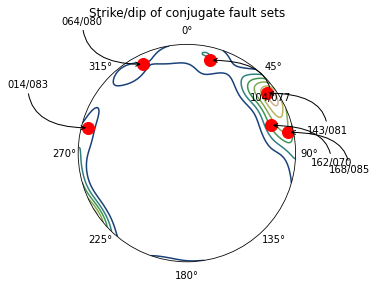

In [159]:
# Cluster set of planes
n_clusters = 6

# Plot the raw data and contour it:
fig, ax = mpl.subplots()
#ax.density_contourf(strike, dip, rake, measurement='rakes', cmap='gist_earth',
#                    sigma=1.5)
ax.density_contour(strike, dip, cmap='gist_earth',  measurement='poles', sigma=1.5)
#ax.rake(strike, dip, marker='.', color='black')

# Find the two modes
centers = mpl.kmeans(strike, dip, num=n_clusters, measurement='poles') # Função instável a ser substituída
strike_cent, dip_cent = mpl.geographic2pole(*zip(*centers))
ax.pole(strike_cent, dip_cent, 'ro', ms=12)

labels = np.full((np.size(strike)), 0, dtype=np.int)
distances = np.full((np.size(strike), 1), np.inf)

for i in range(np.shape(centers)[0]):
    center = centers[i]
    for j in range(0, np.shape(strike)[0]):
      lat, lon = mpl.analysis._convert_measurements((strike[j], dip[j]), measurement='poles')
      angle = mpl.stereonet_math.angular_distance(center, (lat, lon))
      if angle < distances[j]:
          distances[j] = angle
          labels[j] = i

# Label the modes
for (x0, y0) in centers:
    s_label, d_label = mpl.geographic2pole(x0, y0)
    x, y = mpl.pole(s_label, d_label) # Otherwise, we may get the antipode...

    if x > 0:
        kwargs = dict(xytext=(40, -40), ha='left')
    else:
        kwargs = dict(xytext=(-40, 40), ha='right')

    ax.annotate('{:03.0f}/{:03.0f}'.format(s_label[0], d_label[0]), xy=(x, y),
                xycoords='data', textcoords='offset points',
                arrowprops=dict(arrowstyle='->', connectionstyle='angle3'),
                **kwargs)

ax.set_title('Strike/dip of conjugate fault sets', y=1.10)

plt.show()

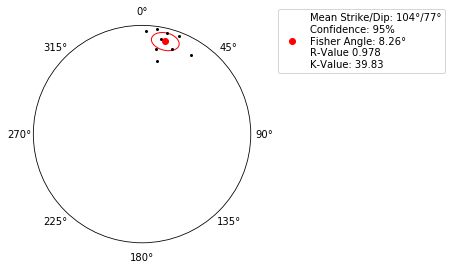

-----


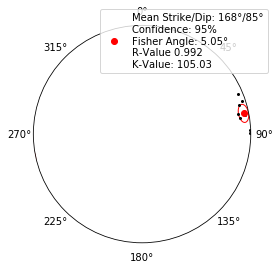

-----


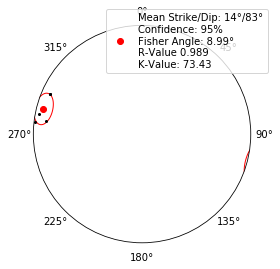

-----


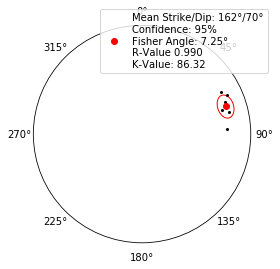

-----


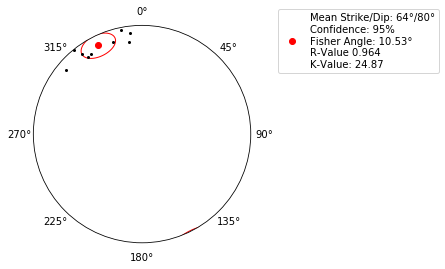

-----


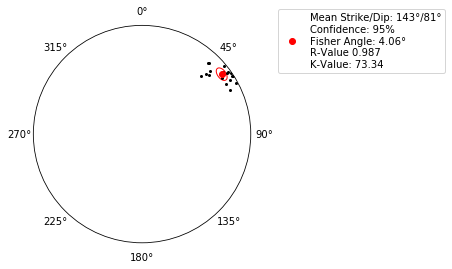

-----


In [22]:
n_clusters = 6
labels = np.asarray([5, 5, 5, 0, 3, 3, 5, 0, 5, 5, 1, 5, 5, 0, 4, 4, 4, 1, 4, 0,
                     5, 4, 5, 4, 1, 5, 5, 1, 3, 3, 1, 0, 0, 3, 2, 2, 4, 0, 0, 5,
                     4, 5, 5, 1, 5, 1, 4, 0, 1, 5, 2, 2, 1, 5, 2, 3])
# Compute Fisher statistics for each set
plane_stats = []
for group in range(0, n_clusters):
    if np.size(plunge[np.where(labels == group)]) > 1:
        mean_strike, mean_dip, stats = fisher_plot(plunge[np.where(labels == group)],
                                                   bearing[np.where(labels == group)],
                                                   strike[np.where(labels == group)],
                                                   dip[np.where(labels == group)])
        
        plane_stats.append((mean_strike, mean_dip, stats[0], stats[1], stats[2]))
        #print(mpl.find_fisher_stats(strike[np.where(labels == group)], dip[np.where(labels == group)], measurements = 'poles', conf=95))
        #print(fisher_stats(plunge[np.where(labels == group)], np.asarray(bearing)[np.where(labels == group)]))
    else:
        fig = plt.figure()
        ax = fig.add_subplot(111, projection='stereonet')
        ax.pole(strike[np.where(labels == group)],
                dip[np.where(labels == group)], color="red")
        plt.show()
        plane_stats.append((strike[np.where(labels == group)],
                dip[np.where(labels == group)], 1, 0, np.inf))
        print(strike[np.where(labels == group)], dip[np.where(labels == group)])
    print("-----")

plane_stats = np.reshape(plane_stats, (np.shape(plane_stats)[0], 5))

In [356]:
labels

array([5, 5, 5, 0, 3, 3, 5, 0, 5, 5, 1, 5, 5, 0, 4, 4, 4, 1, 4, 0, 5, 4,
       5, 4, 1, 5, 5, 1, 3, 3, 1, 0, 0, 3, 2, 2, 4, 0, 0, 5, 4, 5, 5, 1,
       5, 1, 4, 0, 1, 5, 2, 2, 1, 5, 2, 3])

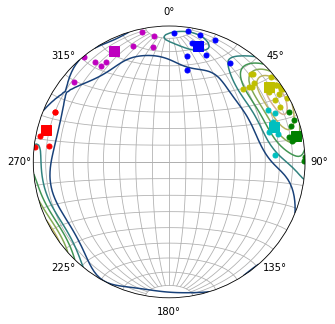

In [232]:
#colors = list(np.asarray((list(mcolors.BASE_COLORS), list(mcolors.BASE_COLORS))))
#colors = np.asarray((np.random.random(20), np.random.random(20), np.random.random(20))).T
colors = ['b', 'g', 'r', 'c', 'm', 'y', 'k', 'b', 'g', 'r', 'c', 'm', 'y', 'k']

fig = plt.figure(figsize=(5,5))
ax = fig.add_subplot(111, projection='stereonet')
ax.density_contour(strike, dip, cmap='gist_earth',  measurement='poles', sigma=2)

for i in range(0, n_clusters):
    ax.pole(strike_cent[i], dip_cent[i], colors[i]+'s', markersize=10) # marker = '.'

for i in range(0, np.size(dip)):
    #ax.plane(strike[i], dip[i], colors[labels[i]]+'-', linewidth=2)
    ax.pole(strike[i], dip[i], colors[labels[i]]+'.', markersize=10)
    #ax.line(plunge[i], bearing[i], colors[labels[i]]+'o', markersize=10)

    #ax.rake(strike[i], dip[i], -25)
ax.grid()

plt.show()

In [23]:
# Fisher statistics results
print('Fisher statistics')
print('Strike / Dip / r_value, Fisher_angle, K')
for i in range(0, np.shape(plane_stats)[0]):
    print(plane_stats[i])

print('\n K-means strike/dip centers')
print(np.asarray((strike_cent, dip_cent)).T)

Fisher statistics
Strike / Dip / r_value, Fisher_angle, K
[104.1323379   76.91346146   0.97768524   8.25735679  39.83412547]
[168.46609819  84.74982395   0.99153658   5.04693458 105.02709744]
[14.36602166 82.98433193  0.98910565  8.9877203  73.43257634]
[161.76441133  69.96858828   0.99034597   7.25178248  86.31970406]
[63.6332316  80.28613447  0.9642532  10.5293828  24.86625083]
[143.04370973  80.90737602   0.98712272   4.06345943  73.34190121]

 K-means strike/dip centers


NameError: name 'strike_cent' is not defined

## 3D spacing

Discontinuity spacing analysis in rock masses using 3D point clouds. Riquelme, 2015

Development and application of UAV-SfM photogrammetry for quantitative characterization of rock mass discontinuities. Kong, 2021

In [24]:
# Compute spacing statistics. Returns mean distance, standard deviation, and median
spacing_stats = []
for cluster in range(0, n_clusters):
    #np.asarray(a)[np.where(labels==cluster)]
    a_mean = np.mean(np.asarray(a)[np.where(labels==cluster)])
    b_mean = np.mean(np.asarray(b)[np.where(labels==cluster)])
    c_mean = np.mean(np.asarray(c)[np.where(labels==cluster)])

    d_temp = np.copy(np.asarray(d)[np.where(labels==cluster)])

    d_temp.sort()

    spacing = []

    for i in range(np.size(d_temp)-1):
        SP = abs(d_temp[i] -d_temp[i+1])/math.sqrt(math.pow(a_mean,2) + math.pow(b_mean,2) + math.pow(c_mean,2))
        spacing.append(SP)

    #for x, y in it.combinations(list(range(np.shape(d_temp)[0])), 2):
    #    SP = abs(d[x] -d[y])/math.sqrt(math.pow(a_mean,2) + math.pow(b_mean,2) + math.pow(c_mean,2))
    #    spacing.append(SP)
    #spacing.sort()
    if np.size(spacing) > 1:
        spacing_stats.append((np.mean(spacing), np.std(spacing), np.median(spacing)))
    else:
        print(spacing)
spacing_stats = np.reshape(spacing_stats, (np.shape(spacing_stats)[0], 3))

# Sochastic modelling

## Random sampling from Fisher distribution

In [64]:
new_normals = []
new_distances = []

model_dimension = 1000

for group in range(0, n_clusters):
    
    # Compute plane quantities
    n_fractures = int(model_dimension/spacing_stats[group,0])
    if n_fractures == 0:
        n_fractures = 1

    # Compute plane directions
    mean_strike, mean_dip, vector, r_fisher, k_fisher = plane_stats[group]
    lon, lat = mpl.pole(mean_strike, mean_dip)
    new_lat, new_lon = spherical_kde.distributions.VonMisesFisher_sample(lat[0], lon[0], np.deg2rad(r_fisher), size=n_fractures)
    #newstrike, new_dip = mpl.geographic2pole(new_lon, new_lat)
    normal = mpl.stereonet2xyz(new_lon, new_lat)
    normal = [normal[0], normal[1], normal[2]]
    new_normals.append(np.rot90(normal))

    # Compute plane distances
    new_distances.append(np.random.normal(spacing_stats[group,0], spacing_stats[group,1], n_fractures).cumsum())

## Random 3d plane drawing

In [67]:
model_center = model_dimension/2
size = 2400 # plane size
# points = np.asarray([[-1, 0,-1],[1,0,-1],[1,0,1], [-1,0,1]]) # base vertical square
points = np.asarray([[-1, -1,0],[1,-1,0],[1,1,0], [-1,1,0]]) # base horizontal square
points = points*size

#['b', 'g', 'r', 'c', 'm', 'y', 'k', 'b', 'g', 'r', 'c', 'm', 'y', 'k']
surfacecolors = ['blue', 'green', 'red', 'cyan', 'magenta', 'yellow']

new_centroids = []
_new_normals = []

def vnorm(vector):
    vector = np.asarray(vector, dtype=np.float64)
    return math.sqrt(np.sum(np.power(vector, 2)))

scene=dict(camera=dict(eye=dict(x=1.15, y=1.15, z=0.8)), #the default values are 1.25, 1.25, 1.25
           xaxis=dict(),
           yaxis=dict(),
           zaxis=dict(),
           aspectmode='manual', #this string can be 'data', 'cube', 'auto', 'manual'
           #a custom aspectratio is defined as follows:
           aspectratio=dict(x=1, y=1, z=1)
           )
layout = go.Layout(width=800, scene=scene)
fig = go.Figure(layout=layout)

for i in range(0, n_clusters):
    for j in range(0, np.shape(new_distances[i])[0]):
        normal = new_normals[i][j]
        distance = new_distances[i][j]

        #lon, lat = mpl.pole(150, 90)
        #normal = mpl.stereonet2xyz(lon, lat)
        #normal = [normal[0][0], normal[1][0], normal[2][0]]
        #centroid = np.asarray((np.random.uniform(0,100),np.random.uniform(0,100), np.random.uniform(0,100)))

        normal = np.array(normal)*distance

        _new_normals.append(normal)

        if normal[0] < 0 and normal[1] < 0:
           normal = -normal

        centroid = np.asarray([0,0,0]) + normal

        if centroid[0] < 0 or centroid[1] < 0 or centroid[2] < 0:
           centroid = centroid

        new_centroids.append(centroid)
        # d = -centroid.dot(normal)
        # centroid = ?


        new_points = plane_rotate(points, normal, centroid)

        fig.add_traces(go.Scatter3d(x= new_points[:,0], y= new_points[:,1],
                                    z= new_points[:,2], mode='lines',
                                    surfacecolor = surfacecolors[i],
                                    surfaceaxis=0, name=str(centroid)) )

        
#lon, lat = mpl.pole(150, 90)
#normal = mpl.stereonet2xyz(lon, lat)
#normal = [normal[0][0], normal[1][0], normal[2][0]]

#centroid = np.asarray([50,50,50])
#new_points = plane_rotate(points, normal, centroid)

#fig.add_traces(go.Scatter3d(x= new_points[:,0], y= new_points[:,1],
#                            z= new_points[:,2], mode='lines',
#                            surfacecolor = 'black',
#                            surfaceaxis=0, name=None) )



# fig.update_scenes(aspectmode = "data")
# fig.update_scenes(aspectratio_x=1)
# fig.update_scenes(aspectratio_y=1)
# fig.update_scenes(aspectratio_z=1)

fig.update_scenes(xaxis_range=(0,model_dimension))
fig.update_scenes(yaxis_range=(0,model_dimension))
fig.update_scenes(zaxis_range=(0,model_dimension))
fig.update_scenes(camera_projection_type="orthographic")
fig.write_html("model.html")
fig.show()

## Compute volumetric statistics

In [150]:
# Generate P32 box positions
#model_dimension = 1000

# Data range
x_range = [0, model_dimension]
y_range = [0, model_dimension]
z_range = [0, model_dimension]

cube_size = 10

# Maximum quantity of cubes in each dimension
maxX = (x_range[1] - x_range[0])/(cube_size*2)
maxY = (y_range[1] - y_range[0])/(cube_size*2)
maxZ = (z_range[1] - z_range[0])/(cube_size*2)

offsets = []
for i in range(0, math.ceil(maxX)):
    for j in range(0, math.ceil(maxY)):
        for k in range(0, math.ceil(maxZ)):
            x0 = float(i*cube_size*2) + cube_size + int(x_range[0])
            y0 = float(j*cube_size*2) + cube_size + int(y_range[0])
            z0 = float(k*cube_size*2) + cube_size + int(z_range[0])
            offsets.append((x0, y0, z0))

In [151]:
np.shape(offsets)

(125000, 3)

In [154]:
#cube_size = 100
#offsets = [[250, 250, 250]]

import time

_new_normals = np.asarray(_new_normals)
new_centroids = np.asarray(new_centroids)


start_time = time.time()
intensity_values = compute_p32_statistics(_new_normals, new_centroids, offsets, cube_size)
end_time = time.time()
print(end_time-start_time)

9846.42641043663


In [155]:
intensity_values = np.asarray(intensity_values)
aux = intensity_values[np.where(intensity_values > 0)]
print(np.mean(intensity_values), np.std(intensity_values))
print(np.mean(aux), np.std(aux))

0.14631721412792348 0.09204077530425421
0.15349204634214042 0.08823624288814268


In [149]:
#intensity_values = [0.41089712542387885, 0.3652348034524301, 0.8440326307626328, 0.6085776737558112, 0.6766728781961521, 0.45298076774930285]

if np.size(intensity_values) > 1:
    hue = 180-(intensity_values-np.min(intensity_values))/(np.max(intensity_values)- np.min(intensity_values))*180
else:
    hue = [120-(intensity_values[0]*120)]


cube_list = []
i = 0
for offset in offsets:

    #cube = original_cube + offset
    #edges = original_edges + offset
    
    if intensity_values[i] > 0:

        cube_definitions = Cube(cube_size, offset)
        vertices = cube_definitions.vertices

        aux = go.Mesh3d(
                        # 8 vertices of a cube
                        x=vertices[:,0],
                        y=vertices[:,1],
                        z=vertices[:,2],
                        color = 'hsv('+ str(hue[i]) + ', 60, 50)',
                        # Intensity of each vertex, which will be interpolated and color-coded
                        #intensity = np.linspace(0, 1, 8, endpoint=True),
                        # i, j and k give the vertices of triangles
                        #i = [7, 0, 0, 0, 4, 4, 6, 6, 4, 0, 3, 2],
                        #j = [3, 4, 1, 2, 5, 6, 5, 2, 0, 1, 6, 3],
                        #k = [0, 7, 2, 3, 6, 7, 1, 1, 5, 5, 7, 6],

                        i = [0,2,0,0,1,4,4,4,0,0,2,2],
                        j = [2,6,5,2,4,7,3,7,1,3,5,6],
                        k = [3,3,1,5,5,5,6,6,4,4,7,7],
                        name=intensity_values[i],
                        showscale=False
                    )
        cube_list.append(aux)
    
    i += 1

scene=dict(camera=dict(eye=dict(x=1.15, y=1.15, z=0.8)), #the default values are 1.25, 1.25, 1.25
           xaxis=dict(),
           yaxis=dict(),
           zaxis=dict(),
           aspectmode='data' #this string can be 'data', 'cube', 'auto', 'manual'
           #a custom aspectratio is defined as follows:
           #aspectratio=dict(x=100, y=60, z=4)
           )
layout = go.Layout(width=600, scene_camera_eye_z=0.75, scene=scene)
fig = go.Figure(data=cube_list, layout=layout, )
#fig = go.Figure(data=cube_list)

fig.show()

In [153]:
fig.write_html("stochastic_3d.html")

C:\Users\adeju\.conda\envs\tensorflow-cpu\lib\site-packages\mplstereonet\stereonet_transforms.py:139: RuntimeWarning:

invalid value encountered in arcsin



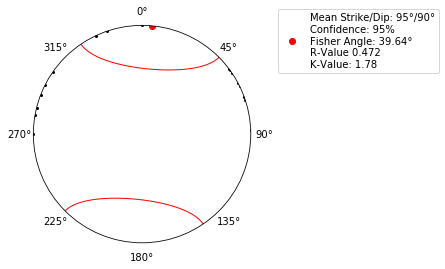

In [123]:
strike_2d = [ 90.,  21.,  65.,  35.,   0., 178.,  14., 154.,  27., 160.,  10.,
       144., 143., 152., 146., 162.,  71.]
dip_2d = [90]*17
plunge_2d, bearing_2d = mpl.pole2plunge_bearing(strike_2d, dip_2d)
mean_strike, mean_dip, stats = fisher_plot(plunge_2d, bearing_2d, strike_2d, dip_2d)

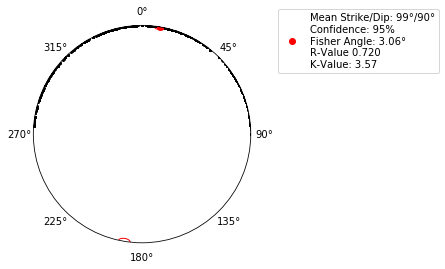

In [131]:
strike_bisdom = np.asarray([148, 158, 159,  70,  72,  72, 159, 165, 111, 129,  99, 150, 153,
        97, 153, 153,  67,  90,  97, 104,  27, 153, 153, 163,  76,  76,
        79,  81,  90,  72,  80,  76,  77,  68,  72,  63,  76,  74,  82,
        72,  69,  63,  72,  63,  76,  76,  72,  56,  79,  76,  72,  72,
        63,  56,  76,  63,  53,  45,  63,  68,  76,  70,  75,  73,  84,
        58,  69,  72,  69,  56,  45,  60,  51,  45,  73,  68, 153,  86,
       159,  77,  76,  63, 158, 162,  72,  68,  76, 106, 144, 126, 118,
       127, 146, 151,  45, 177, 150,  86, 158, 156, 150,  81, 148, 147,
        84, 148,  90,  63, 159,  45,  94,  79,  82,  53, 124,  34, 146,
       162,  32,   8, 108, 113, 117, 153, 117,  17, 107,  30, 117, 127,
       124, 117, 117, 117,  59,  70, 158,  71, 151, 150,  86, 157, 164,
        77, 165,  90, 157,  76, 153, 149, 154,  94,  97, 151,  73,  73,
        75,  84,  85,  34,  35,  15, 153, 146,  71, 141,  84,  80,  25,
       155, 176,  76,  79,  82,  85, 180,  79,  94, 108, 112, 106,  76,
       159, 113,  18, 122, 124, 113, 163,  72, 180, 108, 124,  99, 117,
       121, 122,  31,  18,  45,  96,  29, 112, 117, 117, 108,  90, 124,
       103, 119, 117,  79,   7,  90,  28,  73, 175,  50,  99,  38, 150,
        90,  90,   7, 108, 174,  99,  82, 169, 100, 158, 169, 162, 153,
       162,  90, 104, 108, 101, 135, 129,  34, 175, 149,  77,  75, 171,
         4,  70,  60,  63, 180, 124, 146,  69,  96, 180,  40, 121,  90,
        76, 111,  50, 106,  37, 108, 116,  20, 151, 104, 102, 107,  18,
        18, 126, 129, 122, 120,  66, 176, 129, 120, 146, 120, 119, 117,
        27, 108, 157, 159,  27,  90, 117, 108, 166, 117, 105, 180, 180,
       180,  22, 101,  22, 163,   7,  90,  99,  27,  27, 180,  45,  27,
       117, 104,  63,  72,  72,  90,  32,  24, 111, 117,  11,  59,  90,
        34,  90,  72,  56, 127, 117, 110, 124, 108,  68,  63,  70,  27,
       180,   9,  22,  63,  72,  84,  90,  66,  95, 138, 105, 180,  58,
        67,  82,  63,  73, 143,  96, 180,  88, 107,  90, 101, 108, 111,
       180, 180, 102,  54, 146, 111,  90, 112, 127, 104, 113,  92,  79,
        72, 180, 120,  22,  14, 112, 106, 114, 115, 111,  90, 160,  90,
        59,  34,  96,  90,  52, 112,  27, 180,  27,   8,  76, 163,  29,
       112, 173, 180, 107,  24,  45,  45,  35,  45, 107, 101,  35,   4,
        90,  94,  27,  90,  39,  90,  90,  90,  90, 162,  90,  90, 137,
        90,  90,  87, 143,  68,  84,  83,  85,   6, 180, 147, 106, 104,
        11,   9, 180,  68, 180, 180,   8,  61,  13,  11,   9,  14, 145,
       143, 141,  29,  30, 146, 145,  58,  66,  59, 104, 102, 170, 164,
       111, 110, 151, 145, 180,  12,  47,  38,  66,  45,  78,  30,  39,
        63, 148, 150, 175, 145, 176, 153,  84, 124, 180,  20,  90, 140,
        30, 150,  18,  13, 178,  72,  49, 175, 148,  43,  44, 151, 148,
       150,  74,  72,  77,  13,  75,  67, 119,  59, 109,  36,  84, 155,
       154,  71,  67, 172, 153,  84,  73,   5, 141, 159, 148, 149, 150,
       152, 153, 146, 100, 146, 144, 160, 105,  90,  95,  97, 149,  90,
        79, 101,  90,  96,  90,  95,  94,  90,  90, 104,  96, 101, 148,
       106, 108, 113, 102, 151, 101, 114, 104,  96, 103, 104, 174, 111,
       115,  93, 147,  93,  92,  90,  93,   9, 152,   8,  81,  77, 156,
       153,  76,  90, 111, 180, 112,  90, 117, 108, 108, 158, 111,   7,
       127, 117,  96,  90, 162, 108,  41, 104,  80,  76, 180,  98,  90,
        90, 114,   5,  27,  24, 103,  99,  98, 112,  45, 135, 135, 153,
       153, 153, 153, 106, 158,  53,  90, 153, 166, 149, 146, 180, 180,
       146, 153, 153,  96,  94,  90,  90, 101,  63,  63, 108, 117,  90,
        85, 166,  98, 108,  99,  72,  69, 153, 135, 166,  63,  99,  90,
       111,  96,  94, 112, 102, 104,  79, 117, 104, 107, 112,  90, 105,
       180,  70, 127, 162, 107, 114, 104, 101,  90,  98,  27, 180, 180,
        90, 103, 108,  27, 108, 106,  39, 180, 125, 135, 121,  14,   9,
       135, 172, 143,  20,  45,  63, 146, 162, 153,  58, 157, 180,  56,
        56, 151,  55, 101,  70, 146,  72, 149,  56, 153, 146,  76,   8,
        90,  76, 167,  96,  90, 180,  82, 124,  45,  21,  74,  87,  97,
        32,  72,  47,   9,  81,  52,  70,   5, 155, 135,  28,  90,  68,
       117, 162, 180,  87,  65, 160, 165, 165, 163, 164, 180,  33,  60,
        45, 165,  56,  58, 135,  68,  67, 104,  98,  97, 104,  90, 153,
        56, 103, 113,  80,  85, 117, 119, 180,   7,  45,  85,  80,  23,
       146,  90, 115,  94,  90, 171, 101, 145, 146, 151,  90,  53, 106,
        27,  41,  47,  45,  90, 159, 180,  82,  76, 180, 174, 111,  86,
         4], dtype=np.float64)
dip_bisdom = np.asarray([90]*np.size(strike_bisdom), dtype=np.float64)
plunge_bisdom, bearing_bisdom = mpl.pole2plunge_bearing(strike_bisdom, dip_bisdom)
mean_strike, mean_dip, stats = fisher_plot(plunge_bisdom, bearing_bisdom, strike_bisdom, dip_bisdom)
